# Introducción al manejo de datos geográficos

# Clase 2

## Parte 3. Estrategias de visualización espacial
### Mapeando resultados...

#### Un recorrido por varias librerías

In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd
from shapely.geometry import Point
import pyproj

In [2]:
fachadas_sndg = pd.read_csv('../data/fachadas_sndg.csv')

In [3]:
fachadas_sndg.head(2)

,seccion,manzana,parcela,partida,calle_nombre,calle_altura,vencimiento_certificado,direccion,nomenclatura,id,nombre,lat,lon,iddto,nombredto
0,21,2,9,429255.0,"ALVAREZ, JULIAN",2531,2019-03-12,"ALVAREZ, JULIAN 2531","JULIAN ALVAREZ 2531, Comuna 14, Ciudad Autónom...",02000010,Ciudad Autónoma de Buenos Aires,-34.586199585983984,-58.41378826532734,02098,Comuna 14
1,79,89,22,260164.0,"LAMARCA, EMILIO",1014,2019-03-30,"LAMARCA, EMILIO 1014","EMILIO LAMARCA 1014, Comuna 11, Ciudad Autónom...",02000010,Ciudad Autónoma de Buenos Aires,-34.62221828824001,-58.4827026063354,02077,Comuna 11


In [4]:
fachadas_usig = pd.read_csv('../data/fachadas_usig.csv')

In [5]:
fachadas_usig.head(2)

,seccion,manzana,parcela,partida,calle_nombre,calle_altura,vencimiento_certificado,direccion,lat,lon,epsg
0,21,2,9,429255.0,"ALVAREZ, JULIAN",2531,2019-03-12,"ALVAREZ, JULIAN 2531",-34.586111,-58.413591,4326
1,79,89,22,260164.0,"LAMARCA, EMILIO",1014,2019-03-30,"LAMARCA, EMILIO 1014",-34.622146,-58.482847,4326


In [6]:
def construye_coords(x,y):
    try:
        geometria = Point(float(x), float(y)) 
        return geometria
    except:
        return 'sin coordenadas'

In [7]:
def construye_gdf(df,proj):
    
    geom = df.apply(lambda x: construye_coords(x.lon, x.lat), axis=1)
    df['geometry'] = geom
    localizables = df.loc[df['geometry']!='sin coordenadas']
    
    if type(proj) == str:
        crs = pyproj.CRS.from_user_input(proj)
        
    else:
        crs = pyproj.CRS(proj)
    
    gdf = gpd.GeoDataFrame(localizables, crs=crs, geometry=localizables.geometry)
    print('Devolviendo geodataframe con {} casos perdidos'.format(len(df)-len(gdf)))
    return gdf

In [8]:
wkt = """PROJCS["GKBA",
        GEOGCS["International 1909 (Hayford)",
            DATUM["CAI",
                SPHEROID["intl",6378388,297]],
            PRIMEM["Greenwich",0],
            UNIT["degree",0.0174532925199433]],
        PROJECTION["Transverse_Mercator"],
        PARAMETER["latitude_of_origin",-34.6297166],
        PARAMETER["central_meridian",-58.4627],
        PARAMETER["scale_factor",0.999998],
        PARAMETER["false_easting",100000],
        PARAMETER["false_northing",100000],
        UNIT["Meter",1]]"""

In [9]:
gdf_usig = construye_gdf(fachadas_usig,wkt)

Devolviendo geodataframe con 1192 casos perdidos


In [10]:
gdf_sndg = construye_gdf(fachadas_sndg,wkt)

Devolviendo geodataframe con 2369 casos perdidos


Ahora que finalmente tenemos nuestros geodataframes de puntos listos veamos si las dos herramientas nos devuelven los mismos resultados. Para eso, repasemos algunos conceptos básicos de visualzación. Cuando trabajamos con algunas librerías como matplotlib, es necesario tanto la figura donde se van a plotear nuestros gráficos como el lugar que va a ocupar. En líneas generales, lo que nos debe quedar en claro es que la instancia que nosotros creemos para la figura será siempre el método `figure` del módulo `pyplot` de `matplotlib`. Esto nos permitirá definir atributos como el tamaño. Para la posición de la figura, se utiliza el método `add_subplot` (aplicable siempre a un objeto de tipo `pyplot`. Así, se define la forma en la que se disponen las figuras. En nuestro caso, si queremos que el primer mapa se disponga al lado del segundo o, si por ejemplo, queremos superponerlos. 

In [11]:
import matplotlib.pyplot as plt
%matplotlib inline

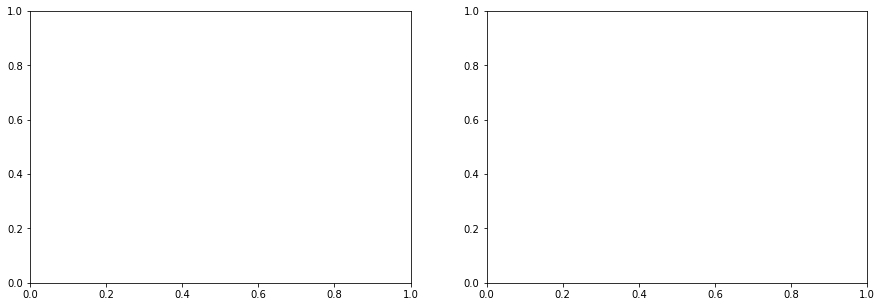

In [12]:
# creamos la figura con un tamaño específico
fig = plt.figure(figsize=(15,5))

# disponemos dos ejes en una columna. El tercero que pasamos como parametro es el número de eje
ax1 = fig.add_subplot(1,2,1)
# acá vemos el eje #2
ax2 = fig.add_subplot(1,2,2)

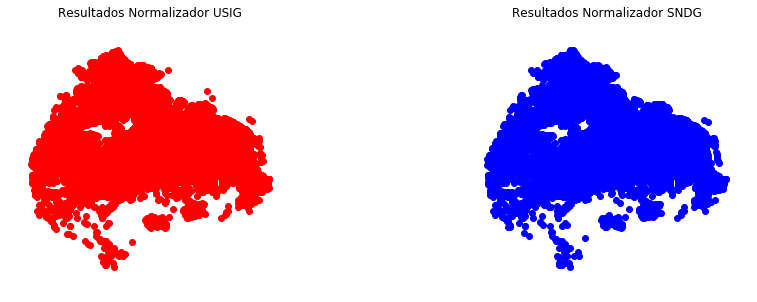

In [13]:
fig = plt.figure(figsize=(15,5))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)

gdf_usig.plot(ax=ax1, color='red')
gdf_sndg.plot(ax=ax2, color='blue')

ax1.set_axis_off()
ax1.set_title('Resultados Normalizador USIG')
ax2.set_axis_off()
ax2.set_title('Resultados Normalizador SNDG');

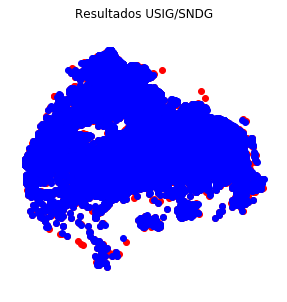

In [14]:
# Si quisieramos verlos superpuestos
fig = plt.figure(figsize=(15,5))
ax = fig.add_subplot(1,1,1)
gdf_usig.plot(ax=ax, color='red')
gdf_sndg.plot(ax=ax, color='blue')
ax.set_axis_off()
ax.set_title('Resultados USIG/SNDG');

Como se puede apreciar, los resultados son bastante similares. Con lo cual, a nivel performance ambos normalizadores trabajaron de manera muy parecida. Pero dónde es que caen esos puntos realmente? En los plots anteriores se puede ver con claridad la forma de la ciudad. De todos modos, es muy común cuando trabajamos con este tipo de situaciones en las que ploteamos algo cuyo resultado inicial nos resulta incierto, querer ver nuestros datos con una especificidad mayor. Hacer zoom, ver en qué polígono cae un punto, el nombre de una calle, etc. Para esto, existen varias librerías que permiten, de una manera muy ágil, plotear figuras sobre un layer dinámico (como si fuese un mapa web). A continuación daremos un pantallazo de algunas de ellas...

> **1. Leaflet**

In [15]:
# importamos la librería
import mplleaflet

In [16]:
# Instanciamos el plot
ax = gdf_usig.head(1000).plot(markersize = 50, color = "red")

# Lo visualiamos con el método display
mplleaflet.display(fig=ax.figure)

/home/federico/CoDeAr/curso-python-data/Clase 7/venv/lib/python3.6/site-packages/IPython/core/display.py:701: UserWarning: Consider using IPython.display.IFrame instead
  warnings.warn("Consider using IPython.display.IFrame instead")


Si prestamos atención al warning, se nos sugiere utilizar `display` de Ipython. Para ello, vamos a tener que, primero, exportar nuestro mapa y traer la ruta a ese `ħtml` que exportamos. Con leaflet también podemos hacer esto.

In [17]:
# Ploteamos la data,
gdf_usig.head(1000).plot(markersize = 50, color = "red");
# la exportamos
mplleaflet.show()

In [18]:
# y la llamamos nuevamente. IFrame nos permite regular el alto y el ancho del output
path = '_map.html'
from IPython.display import IFrame    
IFrame(path, width=1000, height=400)

> **2. Contextily**

Otra es Contextily, una librería muy útil para plotear puntos, polígonos o líneas sobre un layer estático que nos de un primer pantallazo del mapa que buscamos construir.

In [19]:
# importamos la librería
import contextily as ctx

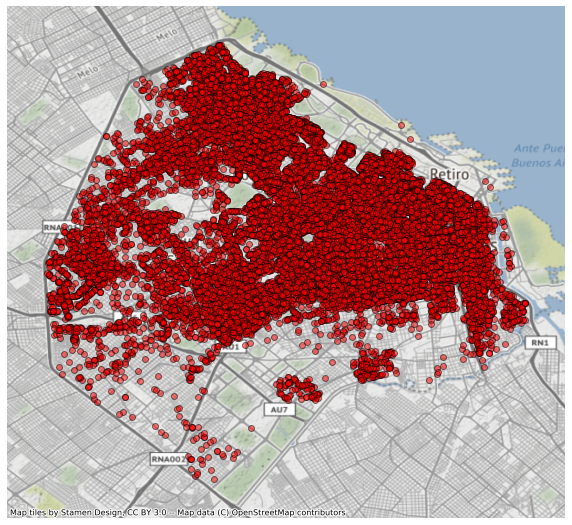

In [20]:
puntos = gdf_usig.plot(figsize=(10, 10), alpha=0.5, color='red', edgecolor='k')
ctx.add_basemap(puntos,zoom=12, crs=4326)
puntos.set_axis_off()

Recuerdan que en la clase anterior, vimos que en la nueva release de `Geopandas` el sistema de proyección de coordenadas (o CRS) había incorporado una mejora en su manera de definirlo? Y recordemos también que, el motivo de este cambio se apoya en la idea de sustitur un `proj4string` (o simplemente un string con información sobre el sistema de proyección utilizado) por un nuevo objeto enriquecido que nos permite acceder a distintos tipos de atributos y métodos. Por ejemplo:

In [21]:
# esta es la información de nuestro crs
gdf_usig.crs

<Projected CRS: PROJCS["GKBA",
        GEOGCS["International 1909  ...>
Name: GKBA
Axis Info [cartesian]:
- E[east]: Easting (Meter)
- N[north]: Northing (Meter)
Area of Use:
- undefined
Coordinate Operation:
- name: unnamed
- method: Transverse Mercator
Datum: CAI
- Ellipsoid: intl
- Prime Meridian: Greenwich

In [22]:
# con la que podemos acceder, por ejemplo al nombre
gdf_usig.crs.name

'GKBA'

In [23]:
# o al datum
gdf_usig.crs.datum

DATUM["CAI",
    ELLIPSOID["intl",6378388,297,
        LENGTHUNIT["metre",1,
            ID["EPSG",9001]]]]

Sin embargo, esta nueva forma de definir el objeto CRS puede tener un impacto importante en el uso de distintas librerías. Y seguramente llevará un tiempo hasta que esto termine siendo totalmente compatible o todas se adapten al uso de este nuevo objecto. El principal causal de esto que existen muchas fuentes y formas de definir un CRS, algunas de las cuales pueden tener una descripción que no se ajusta completamente a los nuevos estándares de PROJ> 6 (cadenas de proj4, formatos WKT más antiguos, etc.). Como se menciona en la documentación oficial de geopandas sobre el [uso de proyecciones](https://geopandas.org/projections.html), en estos casos, el objeto pyproj.CRS que se obteiene, podría contener algunas incosistencias. Por ejemplo, un código EPSG que no se condice con la localización esperada.En el [blog](https://jorisvandenbossche.github.io/blog/2020/02/11/geopandas-pyproj-crs/) de [Joris Van der Boschee](https://jorisvandenbossche.github.io/pages/about.html) se brindan algunas explicaciones adicionales bastante interesantes. 

Pero por qué mencionamos esto ahora? Si prestan atención, en la primera instancia del mapa que construimos con `Contextily` el crs que definimos fue el clásico `4326`. ¿Por qué hicimos esto si nosotros construimos el gdf a partir de un `wkt`? Veamos qué hubiese pasado si definíamos el `CRS` de otra manera.

In [24]:
# Por ejemplo, si hubiésemos querido asignar el crs de otro dataframe cuyo epsg nos es familiar
barrios = gpd.read_file('../carto/barrios_badata.shp')
barrios.crs.datum

DATUM["Campo Inchauspe",
    ELLIPSOID["International 1924",6378388,297,
        LENGTHUNIT["metre",1]],
    ID["EPSG",6221]]

CRSError: Invalid CRS: CRS.from_wkt('PROJCRS["Argentina_GKBsAs",BASEGEOGCRS["Campo Inchauspe",DATUM["Campo Inchauspe",ELLIPSOID["International 1924",6378388,297,LENGTHUNIT["metre",1]],ID["EPSG",6221]],PRIMEM["Greenwich",0,ANGLEUNIT["Degree",0.0174532925199433]]],CONVERSION["unnamed",METHOD["Transverse Mercator",ID["EPSG",9807]],PARAMETER["Latitude of natural origin",-34.6297166,ANGLEUNIT["Degree",0.0174532925199433],ID["EPSG",8801]],PARAMETER["Longitude of natural origin",-58.4627,ANGLEUNIT["Degree",0.0174532925199433],ID["EPSG",8802]],PARAMETER["Scale factor at natural origin",0.999998,SCALEUNIT["unity",1],ID["EPSG",8805]],PARAMETER["False easting",100000,LENGTHUNIT["metre",1],ID["EPSG",8806]],PARAMETER["False northing",100000,LENGTHUNIT["metre",1],ID["EPSG",8807]]],CS["Cartesian",2],AXIS["(E)",east,ORDER[1],LENGTHUNIT["metre",1,ID["EPSG",9001]]],AXIS["(N)",north,ORDER[2],LENGTHUNIT["metre",1,ID["EPSG",9001]]]]')

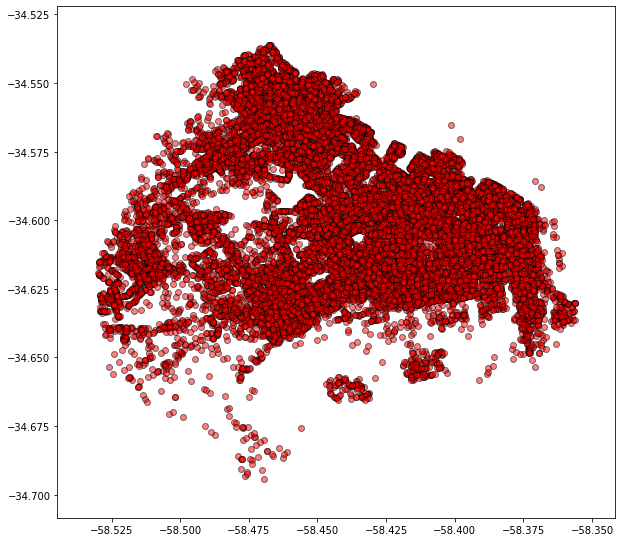

In [25]:
# Primero vemos que nos devuelve un error relativo al crs que definimos desde el wkt
puntos = gdf_usig.to_crs(barrios.crs).plot(figsize=(10, 10), alpha=0.5, color='red', edgecolor='k')
ctx.add_basemap(puntos,zoom=12, crs=barrios.crs)

In [26]:
# Creamos nuestro gdf pero ahora no intentando reproyectar sino asigando el CRS deseado directamente
gdf_usig_crs_barrios = construye_gdf(fachadas_usig,barrios.crs)

Devolviendo geodataframe con 1192 casos perdidos


CRSError: Invalid CRS: CRS.from_wkt('PROJCRS["Argentina_GKBsAs",BASEGEOGCRS["Campo Inchauspe",DATUM["Campo Inchauspe",ELLIPSOID["International 1924",6378388,297,LENGTHUNIT["metre",1]],ID["EPSG",6221]],PRIMEM["Greenwich",0,ANGLEUNIT["Degree",0.0174532925199433]]],CONVERSION["unnamed",METHOD["Transverse Mercator",ID["EPSG",9807]],PARAMETER["Latitude of natural origin",-34.6297166,ANGLEUNIT["Degree",0.0174532925199433],ID["EPSG",8801]],PARAMETER["Longitude of natural origin",-58.4627,ANGLEUNIT["Degree",0.0174532925199433],ID["EPSG",8802]],PARAMETER["Scale factor at natural origin",0.999998,SCALEUNIT["unity",1],ID["EPSG",8805]],PARAMETER["False easting",100000,LENGTHUNIT["metre",1],ID["EPSG",8806]],PARAMETER["False northing",100000,LENGTHUNIT["metre",1],ID["EPSG",8807]]],CS["Cartesian",2],AXIS["(E)",east,ORDER[1],LENGTHUNIT["metre",1,ID["EPSG",9001]]],AXIS["(N)",north,ORDER[2],LENGTHUNIT["metre",1,ID["EPSG",9001]]]]')

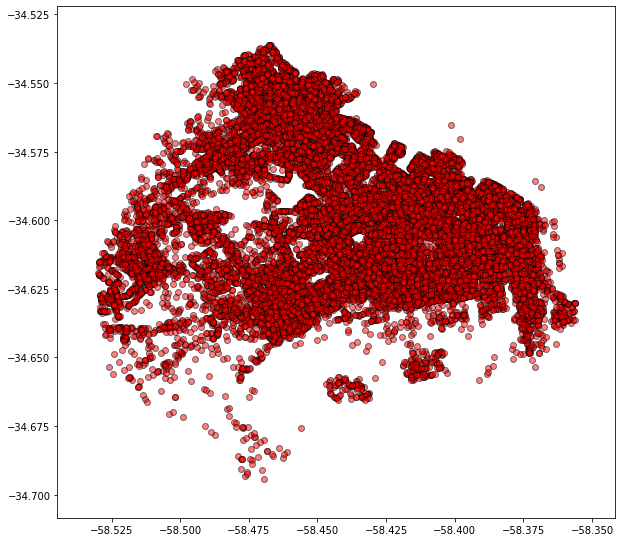

In [27]:
# Y volvemos a intentar la operación
puntos = gdf_usig_crs_barrios.plot(figsize=(10, 10), alpha=0.5, color='red', edgecolor='k')
ctx.add_basemap(puntos,zoom=12, crs=gdf_usig_crs_barrios.crs)

`Contextily` sigue sin reconocer nuestro sistema de coordenadas. Intentemos un camino diferente...

In [28]:
# Veamos en la descripción de nuestro objeto CRS cual es el código EPSG asignado
gdf_usig_crs_barrios.crs.datum

DATUM["Campo Inchauspe",
    ELLIPSOID["International 1924",6378388,297,
        LENGTHUNIT["metre",1]],
    ID["EPSG",6221]]

CRSError: The EPSG code is unknown. EPSG PCS/GCS code 6221 not found in EPSG support files.  Is this a valid EPSG coordinate system?

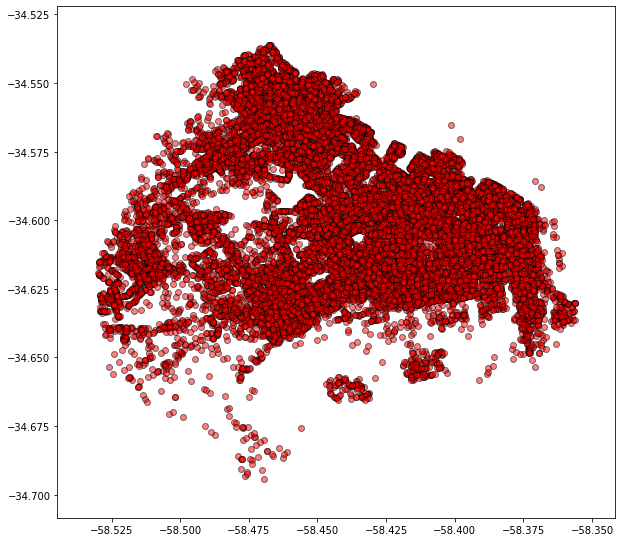

In [29]:
# Y intentemos nuevamente...
puntos = gdf_usig_crs_barrios.plot(figsize=(10, 10), alpha=0.5, color='red', edgecolor='k')
ctx.add_basemap(puntos,zoom=12, crs=6221)

Pueden intentarlo tanto con este código como con el que vimos inicialmente en la descripción de nuestro primer CRS (9001). Ambos devolverán un mensaje de error de `CRS no soportado`. Esto, porque `Contextily` no está reconociendo la definición de ninguno de los dos (el que heredamos de nuestro shape de barrios o el especificado en el wkt). 

Y qué hubiese pasado si apelábamos al [EPSG oficial](https://ramsac.ign.gob.ar/posgar07_pg_web/documentos/Informe_sobre_codigos_oficiales_EPSG.pdf) que corresponde a la faja donde cae la Ciudad de Buenos Aires? Pruébenlo y cuéntennos cómo les va!

De manera diferente, esto no nos hubiese pasado, por ejemplo, con `leaflet`. Como dijimos antes, el impacto que tiene este nuevo objeto no es siempre el mismo. Veamoslo:

In [30]:
# Instanciamos el plot con nuestro nuevo gdf
ax = gdf_usig_crs_barrios.head(1000).plot(markersize = 50, color = "red")

# Y lo visualiamos con el método display
mplleaflet.display(fig=ax.figure)

/home/federico/CoDeAr/curso-python-data/Clase 7/venv/lib/python3.6/site-packages/IPython/core/display.py:701: UserWarning: Consider using IPython.display.IFrame instead
  warnings.warn("Consider using IPython.display.IFrame instead")


In [31]:
# Creamos el gdf con el EPSG que vinos inicialmente en datum
gdf_usig_9001 = construye_gdf(fachadas_usig,9001)

# Y repetimos la operatioria
ax = gdf_usig_9001.head(1000).plot(markersize = 50, color = "red")

mplleaflet.display(fig=ax.figure)

Devolviendo geodataframe con 1192 casos perdidos


/home/federico/CoDeAr/curso-python-data/Clase 7/venv/lib/python3.6/site-packages/IPython/core/display.py:701: UserWarning: Consider using IPython.display.IFrame instead
  warnings.warn("Consider using IPython.display.IFrame instead")


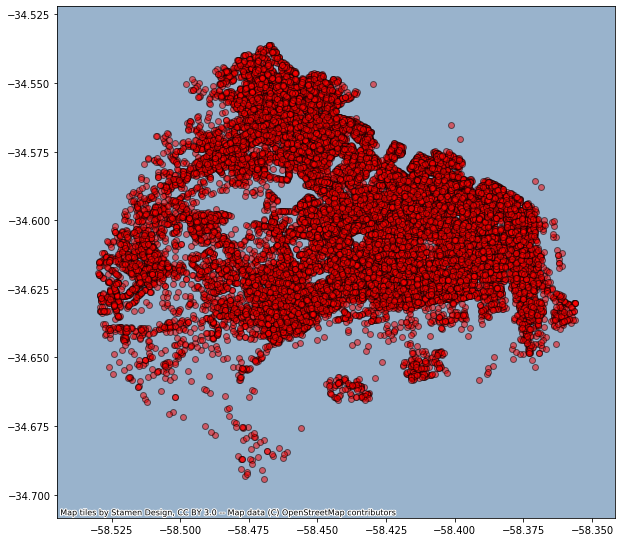

In [32]:
# Este sería el resultado con Contextily si no se especificara el CRS
puntos = gdf_usig_crs_barrios.plot(figsize=(10, 10), alpha=0.5, color='red', edgecolor='k')
ctx.add_basemap(puntos,zoom=12)

En este tipo de circunstancias, algo que es muy recomendable es trabajar directamente en `4326` (para asegurarnos que no tendremos ningún problema de incompatibilidad o falta de soporte). O bien, este nuevo objecto `pyproj.CRS` cuenta con un método `to_epsg()` para devolver un id equivalente. Este es bastante útil para identificar si nuestra proyección (en nuestro caso definida desde un wkt) está siendo identificada correctamente...

In [33]:
# En nuestro caso, vemos que el epsg es un None type, algo que ya nos debería parecer sospechoso
print(gdf_usig.crs.to_epsg())

None


In [34]:
# También podemos acceder a la descripción original si hacemos:
gdf_usig.crs.source_crs

<Geographic 2D CRS: GEOGCRS["International 1909 (Hayford)",DATUM["CAI" ...>
Name: International 1909 (Hayford)
Axis Info [ellipsoidal]:
- lon[east]: Longitude (degree)
- lat[north]: Latitude (degree)
Area of Use:
- undefined
Datum: CAI
- Ellipsoid: intl
- Prime Meridian: Greenwich

In [35]:
# Y veamos también que ahora trabajamos con un nuevo parámetro: min_confidence
gdf_usig.crs.source_crs.to_epsg(min_confidence=20)

4204

Esto se encuentra bastante bien explicado en la documentación de [pyproj](https://pyproj4.github.io/pyproj/stable/gotchas.html#what-is-the-best-format-to-store-the-crs-information). Si el método `to_epsg` no nos devuelve ningún código EPSG que coincida con el wkt o el pyproj4 string que usamos inicialmente (porque no lo encuentra o porque no existe), podemos apelar al parámetro `min_confidence`. Este, nos permitiría obtener el código EPSG más cercano, alternando los umbrales que estamos dispuestos a tolerar.

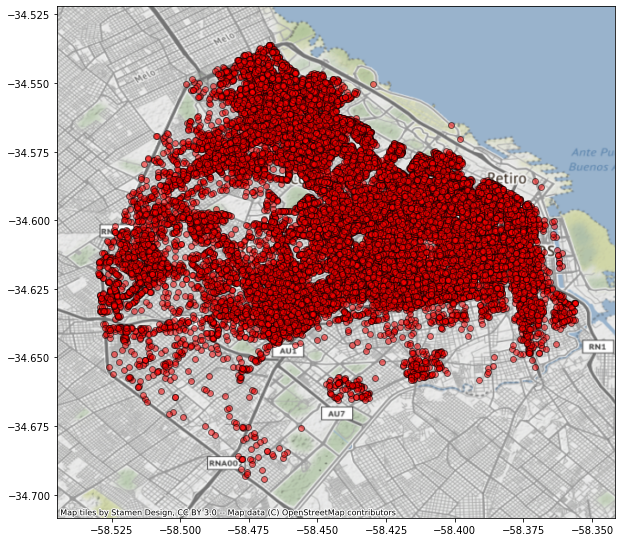

In [36]:
# Vemos que ahora Contextily interpeta el crs...
puntos = gdf_usig.plot(figsize=(10, 10), alpha=0.5, color='red', edgecolor='k')
ctx.add_basemap(puntos,zoom=12, crs=gdf_usig.crs.source_crs.to_epsg(min_confidence=20))

En este caso, si bien el resultado es bastante similar al que obtuvimos con un EPSG igual a 4326, este método nos puede resultar de utilidad para situaciones en las que necesitemos trabajar con una proyección diferente asegurándonos que el mismo sea interpretable.

> **3. Folium**

Folium es una librería que combina distintos tipos de funcionalidades. Desde controles de zoom y la posibilidad de alternar layers hasta clases que devuelven mapas de calor y coropletas.

In [37]:
# Si no lo incluiste en los requirements, lo podemos instalar directo desde el notebook
#!pip install folium

In [38]:
# Importamos la librería
import folium

In [39]:
# Creamos un nuevo gdf en 4326 para los resultados de ambos nomralizadores
sndg_4326 = construye_gdf(fachadas_sndg,4326)

Devolviendo geodataframe con 2369 casos perdidos


In [40]:
usig_4326 = construye_gdf(fachadas_usig,4326)

Devolviendo geodataframe con 1192 casos perdidos


In [41]:
# Convertimos nuestro gdf de puntos en geojson
sndg_gjson = folium.features.GeoJson(sndg_4326.head(1000), name="SNDG")

# Acá podemos ver la estructura
#points_gjson.data.get('features')

# Y ploteamos el mapa...
mapa = folium.Map(location=[-34.6157437, -58.4333812], 
               zoom_start=11, 
               control_scale=True)
sndg_gjson.add_to(mapa);

In [42]:
mapa

In [43]:
def mapa_folium(gdf, polygons, barrio, exporta):
    '''
    Construye un mapa de puntos y/o polígonos sobre
    un layer dinámico de leaflet.
    ...
    Argumentos:
     gdf(GeoDataFrame): Geodataframe de puntos.
     barrio (str): nombre del barrio.
     polygons (GeoDataFrame): GeoDataFrame de polígonos.
     exporta (bool): True para exportar.
     
    Devuelve:
      folium.Map : mapa de puntos/polígonos  
    '''
    
    # Creamos el layer de leaflet. Lo centramos en la Ciudad de Buenos Aires
    centroide =  gdf.geometry.centroid
    coordenadas = [centroide.y.mean(), centroide.x.mean()]
    layer = folium.Map(location=coordenadas, 
                       zoom_start=11, 
                       height = 500,
                       control_scale=True)
    
    
    # Si pasamos polígonos de base, también los cargamos al mapa
    if polygons is not None:
        estilo = lambda x: {'fillColor': 'red' if
                            x['properties']['BARRIO']== barrio else
                            'grey'}
        
        pol_hover= folium.features.GeoJsonTooltip(
                        fields=['BARRIO','COMUNA'],
                        aliases=['Barrio:','Comuna:'])
        
        folium.GeoJson(polygons.to_crs(gdf.crs),
                       name = 'Barrios de la ciudad',
                       style_function = estilo,
                       tooltip = pol_hover
                       ).add_to(layer)

    
    # Agregamos nuestros puntos con el método CircleMarker
    for i, row in gdf.iterrows():
        folium.CircleMarker((row.lat,row.lon),            
                            radius=3, weight=2, 
                            color='blue', 
                            fill_color='blue', 
                            fill_opacity=.5,
                            tooltip= 'Certificado:'+row.vencimiento_certificado).add_to(layer)
    
    
    # Exportar el resultado
    if exporta:
        layer.save('mapa.html')
    
    folium.LayerControl(autoZIndex=False, collapsed=False).add_to(layer)
    
    return layer

In [44]:
# ploteamos un mapa sólo de puntos
mapa_folium(sndg_4326.head(50), None, None, False)

In [45]:
# ahora lo combinamos con un gdf de polígonos
mapa_folium(sndg_4326.head(1000), barrios, 'VILLA LUGANO', False)

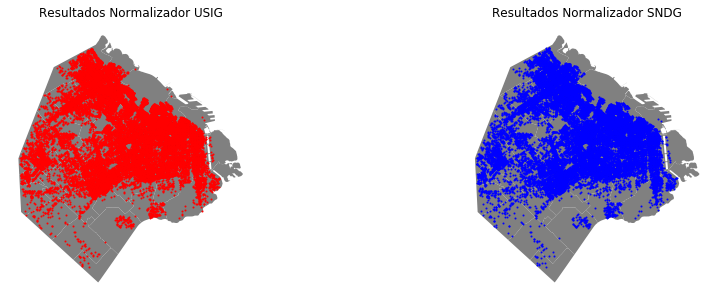

In [46]:
fig = plt.figure(figsize=(15,5))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)

barrios.plot(ax=ax1, color='grey')
usig_4326.to_crs(barrios.crs).plot(ax=ax1, color='red', markersize=1)

barrios.plot(ax=ax2, color='grey')
sndg_4326.to_crs(barrios.crs).plot(ax=ax2, color='blue', markersize=1)


ax1.set_axis_off()
ax2.set_axis_off()

ax1.set_title('Resultados Normalizador USIG')
ax2.set_title('Resultados Normalizador SNDG');

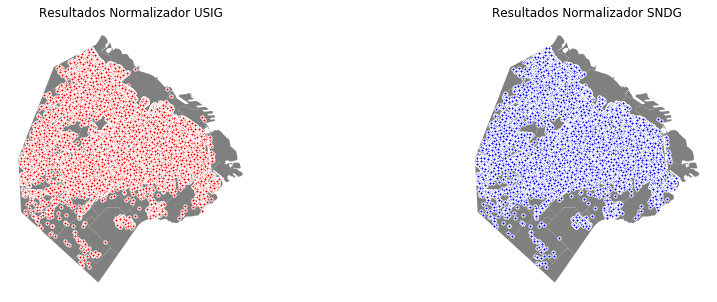

In [47]:
fig = plt.figure(figsize=(15,5))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)

barrios.plot(ax=ax1, color='grey')
usig_4326.to_crs(barrios.crs).plot(ax=ax1, color='red', markersize=10, edgecolor='white')

barrios.plot(ax=ax2, color='grey')
sndg_4326.to_crs(barrios.crs).plot(ax=ax2, color='blue', markersize=10, edgecolor='white')


ax1.set_axis_off()
ax2.set_axis_off()

ax1.set_title('Resultados Normalizador USIG')
ax2.set_title('Resultados Normalizador SNDG');

In [48]:
from folium.plugins import HeatMap

In [49]:
def mapa_de_calor(gdf, radio, inicio, fin):
    '''
    Construye un mapa de calor sobre
    un layer dinámico de leaflet.
    ...
    Argumentos:
     gdf(GeoDataFrame): Geodataframe de puntos.
     radio (int): radio de cada punto.
     inicio (int): límite inferior.
     fin (int): límite superior.
     
    Devuelve:
      folium.Map : mapa de calor  
    '''
    
    # Ubicamos el centro del mapa
    centroide =  gdf.geometry.centroid
    coordenadas = [centroide.y.mean(), centroide.x.mean()]
    
    # Conseguimos la latitud y la longitud de cada punto con una función anónima
    x = gdf["geometry"].apply(lambda punto: punto.x)
    y = gdf["geometry"].apply(lambda punto: punto.y)

    # Convertimos esas coordenadas en una lista de tuplas
    puntos = list(zip(y, x))
    
    # Creamos el layer de leaflet
    layer = folium.Map(location=coordenadas, 
                       zoom_start=11, control_scale=True)

    # Agregamos el mapa de calor al layer que habíamos instanciado
    HeatMap(puntos[inicio:fin], 
            radius=radio).add_to(layer)

    return layer

In [50]:
# también se puede jugar con otros parametros como max_zoom o el tile para elegir otro base map
mapa_de_calor(usig_4326, 15, 1000, 2000)

Para concluir con esta práctica, veamos qué se puede hacer con los datasets que hemos venido construyendo. Un aspecto muy importante en este tipo de situaciones en las que la construcción de nuestros set de datos se vuelve un proceso lento y demandante, es no olvidar o dejar de lado la pregunta que nos va a ayudar a responder. Y no por la pregunta en sí, ya que puede ser una o más. Sino porque, la comunicación de nuestros hallazgos se vuelve mucho más clara cuando respondemos algo en concreto. Por ejemplo, dónde se aglomera nuestra variable de interés? existe algún patrón de localización específico?

Con nuestro mapa de calor, ya pudimos identificar algunas posibles zonas. Sin embargo, vamos a aprovechar esta pregunta para introducir una nueva geometría, un tipo de polígono que no vimos hasta ahora. Este no es nada más y nada menos que el radio censal. Una división o unidad geográfica que utiliza el [Instituto Nacional de Estadísticas y Censos (INDEC)](https://www.indec.gob.ar/indec/web/Institucional-Indec-Codgeo) para sus relevamientos censales. 

Pero no vamos a ahondar mucho en este tema. Simplemente, mencionaremos que una de sus principales ventajas, es la posibilidad de contar con información sociodemográfica a un alto nivel de desagregación territorial (algo que se vuelve importante en términos de acceso a información útil para describir con detalle áreas más reducidas - o con mayor zoom). Tema que retomaremos en otro notebook.

A continuación, veremos un ejemplo en el que utilizaremos los radios solamente por el tamaño de los polígonos (también existen otras librerías muy útiles para lograr este tipo de efectos en nuestros outputs). Haremos un join espacial para ver la cantidad de puntos (nuestras fachadas registradas en las partidas de conservación patrimonial) que caen dentro de nuestros polígonos censales y evaluaremos la concentración de actividad (personas que hayan registrado una fachada) en base a la clasificación de este valor dentro de los radios.

Como vimos en la clase anterior, `Geopandas` cuenta con un módulo bastante útil que nos permite detectar la relación espacial entre dos geometrías. Este se denomina [spatial join](https://geopandas.org/mergingdata.html#spatial-joins) y nos permitira conocer cuántos puntos caen dentro del área de cada polígono.

In [51]:
# importamos el módulo desde gepandas
from geopandas import sjoin

In [52]:
# cargamos el shapefile de radios censales
radios = gpd.read_file('../carto/informacion_censal_por_radio_2010.shp')

In [53]:
# mergeamos ambos gdf
fachadas_r = gpd.sjoin(sndg_4326, radios.to_crs(sndg_4326.crs))

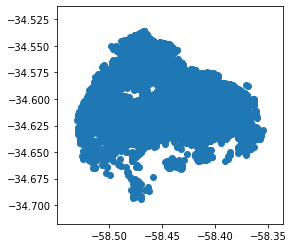

In [54]:
# visualizamos el reultado...
fachadas_r.plot();

In [55]:
# Agrupamos la cantidad de fachadas con certificado de conservación por radio censal
fachadas_por_radio = fachadas_r.groupby(['RADIO_I'])[['partida']].count().reset_index()

In [56]:
# Creamos un diccioanrio donde la key es el id del radio y el value la cantidad de partidas.
d = dict(zip(fachadas_por_radio['RADIO_I'], fachadas_por_radio['partida']))

In [57]:
# Agregamos esta nueva información como columna adicional de nuestro shape original de radios.
radios['partidas'] = radios['RADIO_I'].map(d)

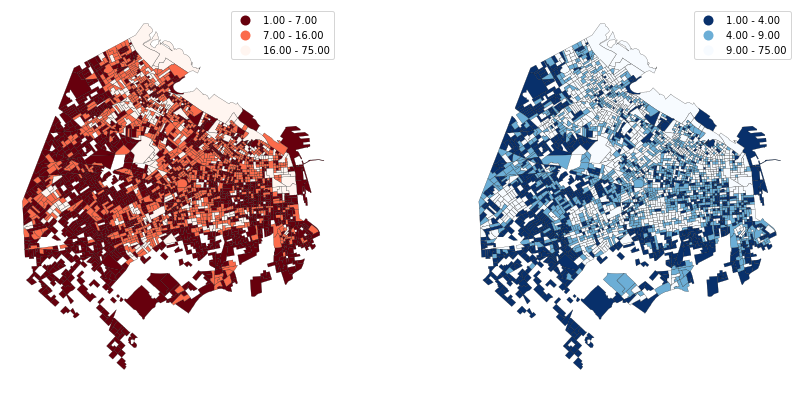

In [58]:
# Hacemos una primera visualización de este resultado.
fig = plt.figure(figsize=(15,7))
ax1 = fig.add_subplot(1,2,1)
ax2 = fig.add_subplot(1,2,2)

radios.to_crs(wkt).plot(ax=ax1, column='partidas', scheme='Natural_Breaks', k=3, 
                        linewidth=0.2, edgecolor='black', cmap='Reds_r', legend=True)
radios.to_crs(wkt).plot(ax=ax2, column='partidas', scheme='Quantiles', k=3, 
                        linewidth=0.2, edgecolor='black', cmap='Blues_r', legend=True)

ax1.set_axis_off()
ax2.set_axis_off()

Vamos a introducir otro tema que retomaremos en el notebook siguiente: esquemas de clasificación. Acá simplemente vamos a comparar dos distintos para detectar si existe algún tipo de diferencia. Como no se pueden apreciar contrastes importantes sólo nos detendremos brevemente en la última distribución. Los `quantiles`.

In [59]:
# reemplazamos los casos sin valor por 0 (en nuestro join espacial muchos polígonos no coincidían con ningún punto)
radios['partidas'].fillna(0,inplace=True)

In [60]:
# calculamos nuestros bins de corte (quantiles). 
qcut = list(radios['partidas'].quantile([0, 0.25, 0.5, 0.75, 1]))

In [61]:
# Esto nos devuelve cinco intervalos, o quintiles que dividen a nuestra población en cinco partes iguales
pd.qcut(radios['partidas'], 5, labels=False).value_counts()

0    820
1    735
2    685
3    657
4    657
Name: partidas, dtype: int64

Qué significa esto? Básicamente que el primer 20% de nuestros radios censales no tendrá fachadas o partidas dentro del área delimitada por los bordes del polígono. El segundo 20%, es decir entre el 20 y el 40% de los casos tendrá un máximo de 2 partidas. Del 40 al 60 será entre 2 y 5, del 60 al 80% entre 5 y 10 y el último quintil (o 20% de nuestros casos) trendrá entre 10 y 75 partidas. Es decir, el más disperso. Pero como dijimos, este tema lo retomaremos en nuestra próxima clase cuando revisemos algunas clases y métodos de la librería `mapclassify`.

In [62]:
# nuestros bins de corte
qcut

[0.0, 2.0, 5.0, 10.0, 75.0]

Ahora, vamos a utilizar la clase `Choropleth` de `Folium` para plotear nuestro agrupamiento por radio. Presten atención a la lógica general. Esta no difiere de los otros mapas que hemos visto. Primero agregar el mapa con `.Map()`(para lo que dejamos seteado un camino que siempre nos devuelva el centro de nuestro gdf a partir de los ceontroides de las latitudes y longitudes). Y luego, ir creando los distintos objetos que iremos agregando como capas superpuestas.

In [63]:
# creamos el mapa
gdf = radios.copy()
centroide =  gdf.geometry.centroid
coordenadas = [centroide.y.mean(), centroide.x.mean()]
layer = folium.Map(location=coordenadas, 
                   zoom_start=11, 
                   height = 500,
                   control_scale=True)

# esto nos permitiría seleccionar entre distintos tiles de base
tiles = ['stamenwatercolor', 'cartodbpositron', 'openstreetmap', 'stamenterrain']
for tile in tiles:
    folium.TileLayer(tile).add_to(layer)

# instanciamos la coropleta
fachadas = folium.Choropleth(name='Radios censales',
                             geo_data=gdf,
                             data=gdf[[c for c in gdf.columns if c!='geometry']],
                             columns=['RADIO_I','partidas'],
                             key_on='properties.RADIO_I',
                             fill_color='Reds_r', 
                             bins = qcut,
                             fill_opacity=0.6, 
                             line_opacity=0.2,
                             highlight=True,
                             legend_name='Cantidad de partidas por radio censal (CNPHV-2010)',
                             smooth_factor=1).add_to(layer)

# creamos un tooltip para hacer un hover en nuestros polígonos
pol_hover = folium.features.GeoJsonTooltip(fields=['BARRIO','RADIO_I','partidas'],
                                           aliases=['Barrio:','Radio_id:','Partidas:'])

# Y lo agregamos al layer inicial
folium.GeoJson(gdf,
               style_function=lambda x: {"weight":0.35, 
                                         'color':'white', 
                                         'fillOpacity':0.0},
               smooth_factor=2.0,
               tooltip=pol_hover).add_to(fachadas);

In [64]:
layer

Es importante remarcar que, en este ejemplo, hemos pasado un geodataframe a la clase `Choropleth` de folium. También podríamos haberle pasado directamente un objeto de tipo `GeoJson`, que es lo que la clase usa para mapear nuestros polígonos (buscar la key, aplicar estilos, etc.). De hecho, si se fijan en el parámetro `key_on`, se accede a la columna de radios a través de la key `properties`. Veamos cómo es eso:

In [65]:
import json

In [66]:
# cargamos un geojson de radios censales (es nuestro mismo gdf que previamente exportamos en este formato)
with open('../carto/radios.geojson') as f:
    rg = json.load(f)

In [67]:
# Vemos las keys...
rg.keys()

dict_keys(['type', 'crs', 'features'])

In [68]:
# y adentro de features, nuestras columnas!
rg['features']

[{'type': 'Feature',
  'properties': {'RADIO_I': '1_1_1',
   'BARRIO': 'RETIRO',
   'COMUNA': '1',
   'POBLACI': 336.0,
   'VIVIEND': 82.0,
   'HOGARES': 65.0,
   'HOGARES_': 19.0,
   'AREA_KM': 1.79899704639142,
   'partidas': 2.0},
  'geometry': {'type': 'Polygon',
   'coordinates': [[[-58.37189370787717, -34.591993639600794],
     [-58.372015858814414, -34.59195978628131],
     [-58.37202781656919, -34.59212961575722],
     [-58.37309466255606, -34.59161191372679],
     [-58.37315416690657, -34.591600603607475],
     [-58.37337843089338, -34.591578060366395],
     [-58.37355692754111, -34.59155926788873],
     [-58.373405194144084, -34.5913927039734],
     [-58.372955603847984, -34.59094294614221],
     [-58.373194808782884, -34.59080479480007],
     [-58.37290159700356, -34.590430207711314],
     [-58.37209327789693, -34.58943853927675],
     [-58.37665514459379, -34.58686588656612],
     [-58.37661854380791, -34.58668698477447],
     [-58.37654518760209, -34.58647946503614],
     

Este primer resultado nos permite ver dos cosas. Primero, una división fuerte entre dos grupos. Si bien nuestro último quintil tiene un amplio rango entre la base y el techo del intervalo, nos sirve para diferenciar dos áreas de la Ciudad. aquellas con nula o casi nula actividad y aquellas donde los radios tienen un número de certificados de conservación superior al techo del resto. 

En otras palabras, los radios censales con más de diez fachadas registradas se concentran desde el centro hacia el oeste, siguiendo la traza de la Avenida Rivadavia hasta poco más de Primera Junta. Y del centro hacia el Norte. Aprovechemos para agregar alguna traza que nos permita ver este efecto con mayor claridad.

In [69]:
# Instanciamos el callejero de la Ciudad, que también bajamos de Buenos Aires Data.
callejero = gpd.read_file('../carto/callejero.shp')

In [70]:
# Filtramos las avenidas
avenidas = callejero.loc[callejero['tipo_c']=='AVENIDA']

In [71]:
# Nos quedamos con algunas trazas que vayan del centro al oeste y del centro al norte
ppales = avenidas.loc[(avenidas['nom_mapa']=='AV. DE MAYO')|(avenidas['nom_mapa']=='AV. RIVADAVIA')|
                     (avenidas['nom_mapa']=='AV. CORRIENTES')|(avenidas['nom_mapa']=='AV. SANTA FE')|
                     (avenidas['nom_mapa']=='AV.CABILDO')]

In [72]:
# Cortamos rivadavia y eliminamos algunas secciones con altura cero
pp_clean = ppales.loc[(ppales['nom_mapa']=='AV. DE MAYO')|
                      ((ppales['nom_mapa']=='AV. RIVADAVIA')&
                      (ppales['alt_izqfin']<8000)&(ppales['alt_derfin']<8000)&
                      # tramos de rivadavia con altura = 0
                      (ppales['id']!=19894)&(ppales['id']!=19844)&(ppales['id']!=19104)&(ppales['id']!=31505))|
                      (ppales['nom_mapa']=='AV. CORRIENTES')|(ppales['nom_mapa']=='AV. SANTA FE')|
                      (ppales['nom_mapa']=='AV.CABILDO')]

In [73]:
# Volvemos a plotear nuestra coropleta. 
gdf = radios.copy()
centroide =  gdf.geometry.centroid
coordenadas = [centroide.y.mean(), centroide.x.mean()]
layer = folium.Map(location=coordenadas, 
                   zoom_start=11, 
                   height = 500,
                   control_scale=True)

tiles = ['stamenwatercolor', 'cartodbpositron', 'openstreetmap', 'stamenterrain']
for tile in tiles:
    folium.TileLayer(tile).add_to(layer)


fachadas = folium.Choropleth(name='Radios censales',
                             geo_data=gdf,
                             data=gdf[[c for c in gdf.columns if c!='geometry']],
                             columns=['RADIO_I','partidas'],
                             key_on='properties.RADIO_I',
                             fill_color='Reds_r', 
                             bins = qcut,
                             fill_opacity=0.6, 
                             line_opacity=0.2,
                             highlight=True,
                             legend_name='Cantidad de partidas por radio censal (CNPHV-2010)',
                             smooth_factor=1).add_to(layer)

pol_hover = folium.features.GeoJsonTooltip(fields=['BARRIO','RADIO_I','partidas'],
                                           aliases=['Barrio:','Radio_id:','Partidas:'])

folium.GeoJson(gdf,
               style_function=lambda x: {"weight":0.35, 
                                         'color':'white', 
                                         'fillOpacity':0.0},
               smooth_factor=2.0,
               tooltip=pol_hover).add_to(fachadas)


# ...pero ahora agregando un layer de calles.
folium.GeoJson(pp_clean,
               name='Avenidas',
               style_function=lambda x: {'weight':2,'color':'#355C7D'},
               highlight_function=lambda x: {'weight':5,'color':'yellow'},
               tooltip=folium.features.GeoJsonTooltip(fields=['nom_mapa','alt_izqfin','alt_derfin'],
                                                      aliases=['Calle:','Altura(izq):','Altura(der):']),
               smooth_factor=5.0,
              ).add_to(layer)

# También agregamos un selector de layers
folium.LayerControl().add_to(layer);

In [74]:
layer

Ahora sí, nuestra choropleta está lista. Qué podemos ver? Inicialmente que la concentración más alta queda denotada por el mismo modelo territorial de la ciudad. Del centro al oeste y del centro al norte (lo que se puede ver a través de las trazas de las avenidas que seleccionamos). Como dijimos anteriormente, si bien el rango es alto (de 10 a 75), nos permite ver una clara diferencia con el resto de la ciudad. Allí es donde se concentran las fachadas que han sido patrimoniadas. Un segundo paso podría ser filtrar este universo y evaluar dónde es que vuelven a concentrarse. Pero ese análisis se lo dejamos a ustedes!